In [1]:
import sncosmo
from astropy.table import Table
import numpy as np
import os
from tqdm import tqdm, trange
import matplotlib.pyplot as plt
import pandas as pd
import scipy
import simplebayesn
from IPython.display import HTML
import astropy
import seaborn as sns

In [2]:
def from_df_to_array_dict(df: pd.DataFrame):
    dfc = df.copy()
    observed_data = {
        'm_app_obs':-2.5*np.log10(dfc['x0'])+10.635,
        'c_app_obs':dfc['c'],
        'x_obs':dfc['x1'],
        'z':dfc['redshift'],
        'sigmaz':dfc['redshift_err']
    }

    for key, value in observed_data.items():
        observed_data[key] = value.to_numpy()
    
    return observed_data

def compute_transformed_cov(row: pd.Series):
    x0 = row['x0']
    
    sigma_x0  = row['x0_err']
    sigma_x1  = row['x1_err']
    sigma_c   = row['c_err']
    cov_x0_x1 = row['cov_x0_x1']
    cov_x0_c  = row['cov_x0_c']
    cov_x1_c  = row['cov_x1_c']

    cov = np.array([
        [sigma_x0**2, cov_x0_c, cov_x0_x1],
        [cov_x0_c, sigma_c**2, cov_x1_c],
        [cov_x0_x1, cov_x1_c, sigma_x1**2]
    ]) 
    J = np.eye(3)
    J[0, 0] = -2.5 / (x0 * np.log(10))

    return J @ cov @ J.T

def from_df_to_cov_array(df: pd.DataFrame):
    return np.stack(df.dropna().apply(compute_transformed_cov, axis=1))

csv_path = '/home/mgiunta/dati/ztf/ztfsniadr2/tables/snia_data.csv'

ztf = pd.read_csv(csv_path, index_col=[0])
# high quality volume limited subset
ztf_hq_vl = ztf.loc[(ztf.fitquality_flag == 1) & (ztf.lccoverage_flag == 1) & (ztf.redshift <= 0.06)]
ztf_hq_vl = ztf_hq_vl.dropna()
# symmetrized color cuts
ztf_hq_vl_sym = ztf_hq_vl.loc[ztf_hq_vl['c'] <= 0.2]

mandel_cuts = ztf.loc[
    (ztf['lccoverage_flag'] == 1) &
    (ztf['x1'] >= -3) &
    (ztf['x1'] <= 3) &
    (ztf['c'] >= -0.3) &
    (ztf['c'] <= 0.3) &
    (ztf['x1_err'] < 1) &
    (ztf['c_err'] < 0.1) &
    (ztf['t0_err'] < 1) &
    (ztf['fitprob'] > 1e-7) &
    (ztf['redshift'] <= 0.06)
].dropna()

data_dict = {k:{'observed_data':from_df_to_array_dict(v),
                'observed_data_cov_arr':from_df_to_cov_array(v)} 
             for k, v in zip(['ztf_hq_vl', 'mandel_cuts', 'ztf_hq_vl_sym'],
                             [ztf_hq_vl, mandel_cuts, ztf_hq_vl_sym])}

In [3]:
cosmo = Table.read('/home/mgiunta/dati/Foundation_DR1/Foundation_DR1.FITRES.TEXT', format='ascii')
cosmo

VARNAMES:,CID,IDSURVEY,TYPE,FIELD,CUTFLAG_SNANA,zHEL,zHELERR,zCMB,zCMBERR,zHD,zHDERR,VPEC,VPECERR,MWEBV,HOST_LOGMASS,HOST_LOGMASS_ERR,HOST_sSFR,HOST_sSFR_ERR,SNRMAX1,SNRMAX2,SNRMAX3,PKMJD,PKMJDERR,x1,x1ERR,c,cERR,mB,mBERR,x0,x0ERR,COV_x1_c,COV_x1_x0,COV_c_x0,NDOF,FITCHI2,FITPROB
str3,str11,int64,int64,str4,int64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64,float64,int64,int64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,float64,int64,float64,float64
SN:,2016afk,150,1,NULL,3,0.04561,1e-05,0.04672,1e-05,0.04686,0.00087,38.929,250,0.049836,9.982,0.002,-9,-9,50.37716,35.34148,-99.0,57440.781,0.28,-0.322701,0.20928,0.0409614,0.0359843,17.48197,0.0431799,0.00182479,7.25723e-05,0.0017881,-3.86106e-06,-2.34128e-06,14,48.11647,1.25747e-05
SN:,2016W,150,1,NULL,3,0.01925,7e-05,0.01856,7e-05,0.02013,0.00085,460.09601,250,0.0598882,11.388,0.002,-9,-9,67.31948,65.90749,-99.0,57417.797,0.124,-1.41159,0.10048,0.0477467,0.0343633,15.54516,0.0398787,0.0108626,0.000398981,4.86729e-05,-6.16387e-06,-1.17336e-05,10,17.96674,0.0555272
SN:,ASASSN-15bc,150,1,NULL,3,0.03672,0.0001,0.03639,0.0001,0.03801,0.00087,467.85101,250,0.0374655,10.187,0.011,-9,-9,68.98033,67.97442,-99.0,57047.805,0.163,0.58245,0.15595,0.0611083,0.030802,16.84699,0.035494,0.00327494,0.000107061,0.000201362,-2.9505e-06,-2.85184e-06,10,4.38669,0.92822
SN:,ASASSN-15fa,150,1,NULL,3,0.02735,1e-05,0.02722,1e-05,0.02726,0.00086,13.425,250,0.0235997,11.268,0.001,-9,-9,70.39776,69.89722,-99.0,57103.422,0.264,-0.436422,0.11261,0.0486535,0.0326272,16.293,0.0371447,0.00545507,0.000186626,3.70113e-05,-1.02296e-06,-5.27885e-06,10,178.46399,4.88194e-33
SN:,ASASSN-15fs,150,1,NULL,3,0.02902,5e-05,0.02852,5e-05,0.02925,0.00086,212.966,250,0.0774664,10.379,0.001,-9,-9,68.67139,68.161,-99.0,57113.352,0.188,-0.00318808,0.12378,0.0101488,0.0318673,15.99948,0.0392377,0.00714839,0.000258338,0.000198606,-2.88999e-06,-7.03224e-06,11,36.95209,0.000117381
SN:,ASASSN-15go,150,1,NULL,3,0.01892,0.00015,0.01927,0.00015,0.01879,0.00086,-140.463,250,0.13748,10.072,0.027,-9,-9,68.29001,66.16085,-99.0,57122.391,0.079,2.78076,0.70536,0.23413,0.0469686,15.85493,0.0565129,0.00816637,0.000425062,0.00549411,-8.44957e-05,-1.63641e-05,4,1.82681,0.76757
SN:,ASASSN-15hg,150,1,NULL,3,0.02992,1e-05,0.03104,1e-05,0.03112,0.00086,25.687,250,0.0420214,10.507,0.006,-9,-9,62.34351,60.30254,-99.0,57131.504,0.549,-1.29938,0.13914,0.0181266,0.0356445,16.60581,0.0436968,0.00408955,0.000164589,-0.0010638,6.52915e-06,-5.00085e-06,10,11.08986,0.35056
SN:,ASASSN-15il,150,1,NULL,3,0.02332,0.00015,0.02373,0.00015,0.02289,0.00087,-247.019,250,0.14965,10.134,0.002,-9,-9,65.64294,65.58196,-99.0,57161.367,0.182,1.25222,0.12132,-0.10349,0.0331336,15.17607,0.0468741,0.0152607,0.000658843,-7.4572e-05,-9.13416e-06,-1.75553e-05,12,40.92266,5.04825e-05
SN:,ASASSN-15jl,150,1,NULL,3,0.03468,1e-05,0.03492,1e-05,0.0352,0.00086,79.629,250,0.0137576,9.101,0.142,-9,-9,61.91462,60.70512,-99.0,57165.977,0.256,0.26532,0.14351,-0.0814384,0.0314825,16.39924,0.0345955,0.00494657,0.000157616,-0.000319142,9.40582e-08,-4.32438e-06,10,25.63908,0.00425715


In [4]:
cosmo['mB'] + 2.5*np.log10(cosmo['x0'])

10.635002230763657
10.63499446886581
10.634998369286977
10.6350008196751
10.635000596513054
10.635002632366302
10.63499880591761
10.635006137317948
10.63500039813411
10.634997034138014
10.635000848075395


In [5]:
df = cosmo.to_pandas()
df

,VARNAMES:,CID,IDSURVEY,TYPE,FIELD,CUTFLAG_SNANA,zHEL,zHELERR,zCMB,zCMBERR,...,mB,mBERR,x0,x0ERR,COV_x1_c,COV_x1_x0,COV_c_x0,NDOF,FITCHI2,FITPROB
0,SN:,2016afk,150,1,NULL,3,0.04561,0.00001,0.04672,0.00001,...,17.48197,0.043180,0.001825,0.000073,0.001788,-0.000004,-0.000002,14,48.11647,1.257470e-05
1,SN:,2016W,150,1,NULL,3,0.01925,0.00007,0.01856,0.00007,...,15.54516,0.039879,0.010863,0.000399,0.000049,-0.000006,-0.000012,10,17.96674,5.552720e-02
2,SN:,ASASSN-15bc,150,1,NULL,3,0.03672,0.00010,0.03639,0.00010,...,16.84699,0.035494,0.003275,0.000107,0.000201,-0.000003,-0.000003,10,4.38669,9.282200e-01
3,SN:,ASASSN-15fa,150,1,NULL,3,0.02735,0.00001,0.02722,0.00001,...,16.29300,0.037145,0.005455,0.000187,0.000037,-0.000001,-0.000005,10,178.46399,4.881940e-33
4,SN:,ASASSN-15fs,150,1,NULL,3,0.02902,0.00005,0.02852,0.00005,...,15.99948,0.039238,0.007148,0.000258,0.000199,-0.000003,-0.000007,11,36.95209,1.173810e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,SN:,SN2017cpu,150,1,NULL,3,0.05440,0.00001,0.05525,0.00001,...,17.10527,0.040269,0.002582,0.000096,-0.002380,0.000003,-0.000003,5,9.56884,8.841550e-02
176,SN:,SN2017hn,150,1,NULL,3,0.02385,0.00001,0.02490,0.00001,...,15.63640,0.038901,0.009987,0.000358,-0.000529,-0.000007,-0.000011,4,2.89850,5.749500e-01
177,SN:,SN2017jl,150,1,NULL,3,0.01633,0.00044,0.01530,0.00044,...,14.49525,0.038542,0.028569,0.001014,0.000090,-0.000017,-0.000028,8,6.28513,6.153300e-01
178,SN:,SN2017mf,150,1,NULL,3,0.02561,0.00001,0.02617,0.00001,...,16.00484,0.036569,0.007113,0.000240,0.000368,-0.000001,-0.000007,5,17.07078,4.367500e-03


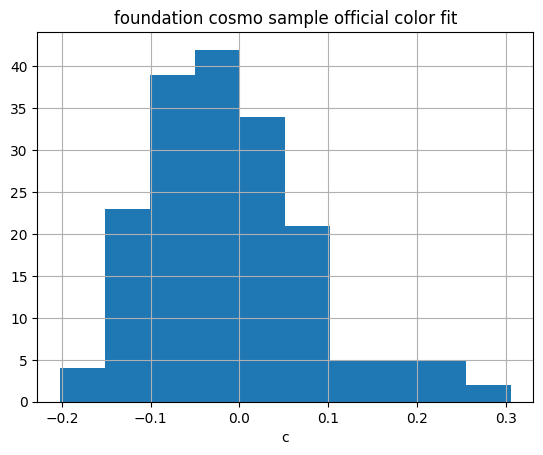

In [6]:
df.c.hist()
plt.xlabel('c')
plt.title('foundation cosmo sample official color fit');

In [7]:
d, t = sncosmo.read_snana_ascii('/home/mgiunta/dati/Foundation_DR1/Foundation_DR1_NoCosmo/Foundation_DR1_ASASSN-15bm.txt', 'OBS')
d, t

(OrderedDict([('SURVEY', 'FOUNDATION'),
              ('SNTYPE', 1),
              ('SNID', 'ASASSN-15bm'),
              ('RA', 226.4647121),
              ('DECL', -5.6271005),
              ('MWEBV', 0.0694),
              ('FILTERS', 'griz'),
              ('REDSHIFT_HELIO', 0.0204316),
              ('REDSHIFT_FINAL', 0.021096560045382518),
              ('SEARCH_PEAKMJD', 57055.65995),
              ('HOSTGAL_LOGMASS', 10.056),
              ('VPEC', 325.84),
              ('VPEC_ERR', 250.0),
              ('PIXSIZE', 0.25),
              ('NOBS', 12),
              ('END', None)]),
 {'OBS': <Table length=12>
      MJD     FLT  FIELD  FLUXCAL  FLUXCALERR   MAG    MAGERR   PSF  
    float64   str1  str4  float64   float64   float64 float64 float64
  ----------- ---- ----- --------- ---------- ------- ------- -------
  57049.65613    g  NULL 37515.646     531.43  16.064   0.015    1.97
  57055.65856    g  NULL 39626.369    558.203  16.005   0.015    2.08
  57073.65651    g  NULL 1

In [8]:
t['OBS']

MJD,FLT,FIELD,FLUXCAL,FLUXCALERR,MAG,MAGERR,PSF
float64,str1,str4,float64,float64,float64,float64,float64
57049.65613,g,NULL,37515.646,531.43,16.064,0.015,1.97
57055.65856,g,NULL,39626.369,558.203,16.005,0.015,2.08
57073.65651,g,NULL,14945.085,216.877,17.064,0.016,1.79
57049.65752,r,NULL,40020.114,559.716,15.994,0.015,1.95
57055.65995,r,NULL,46649.628,651.831,15.828,0.015,1.91
57073.65816,r,NULL,25241.369,356.955,16.495,0.015,2.42
57049.65888,i,NULL,28959.634,408.014,16.346,0.015,1.68
57073.65952,i,NULL,17287.384,247.875,16.906,0.016,1.72
57055.66267,z,NULL,28502.054,410.99,16.363,0.016,1.78


In [9]:
d['REDSHIFT_HELIO']

0.0204316

In [10]:
'ps1::' + t['OBS']['FLT']

ps1::g
ps1::g
ps1::g
ps1::r
ps1::r
ps1::r
ps1::i
ps1::i
ps1::z
ps1::z
ps1::z


In [11]:
t['OBS']['FLT'] == 'g'

array([ True,  True,  True, False, False, False, False, False, False,
       False, False, False])

In [12]:
sncosmo.get_bandpass('ps1::g') # ps1 griz

<Bandpass 'ps1::g' at 0x7fa4b724c440>

In [13]:
astropy.io.fits.open('/home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits').info()

Filename: /home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits
No.    Name      Ver    Type      Cards   Dimensions   Format
  0  PRIMARY       1 PrimaryHDU      41   (0,)      
  1  ZPoff         1 BinTableHDU     19   11R x 5C   [20A, 20A, 1E, 1E, 1E]   
  2  SN SED        1 BinTableHDU     19   97626R x 1C   [1E]   
  3  KCOR          1 BinTableHDU     15   0R x 3C   [1E, 1E, 1E]   
  4  MAG+MWXTCOR    1 BinTableHDU     59   0R x 25C   [1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E]   
  5  FilterTrans    1 BinTableHDU     33   921R x 12C   [1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E, 1E]   
  6  PrimarySED    1 BinTableHDU     15   921R x 3C   [1E, 1E, 1E]   


In [14]:
astropy.io.fits.open('/home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits')[1].data

FITS_rec([('PS1-g', 'AB', 0.   ,  0.        , 0.),
          ('PS1-r', 'AB', 0.   ,  0.        , 0.),
          ('PS1-i', 'AB', 0.   ,  0.        , 0.),
          ('PS1-z', 'AB', 0.   ,  0.        , 0.),
          ('PS1-y', 'AB', 0.   ,  0.        , 0.),
          ('Bessell-U', 'BD17', 9.724, -2.4378977 , 0.),
          ('Bessell-B', 'BD17', 9.907,  0.3850265 , 0.),
          ('Bessell-V', 'BD17', 9.464,  1.4078747 , 0.),
          ('Bessell-R', 'BD17', 9.166,  2.1286292 , 0.),
          ('Bessell-I', 'BD17', 8.846,  3.12189   , 0.),
          ('Bessell-BX', 'BD17', 9.907,  0.42711145, 0.)],
         dtype=(numpy.record, [('Filter Name', 'S20'), ('Primary Name', 'S20'), ('Primary Mag', '>f4'), ('ZPoff(Primary)', '>f4'), ('ZPoff(SNpot)', '>f4')]))

In [15]:
astropy.io.fits.open('/home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits')[2].data

FITS_rec([(1.3000289e-37,), (1.3000289e-37,), (1.3000289e-37,), ...,
          (6.2456838e-11,), (6.0535833e-11,), (5.8701655e-11,)],
         dtype=(numpy.record, [('SN Flux (erg/s/cm^2/A)', '>f4')]))

In [16]:
astropy.io.fits.open('/home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits')[5].data

FITS_rec([( 2100., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
          ( 2110., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
          ( 2120., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
          ( 2130., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
          ( 2140., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
          ( 2150., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00),
          ( 2160., 0.        , 0.   , 0.   , 0.   , 0.   , 0.        , 0.00000000e+00, 0

In [17]:
astropy.io.fits.open('/home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits')[6].data

FITS_rec([( 2100., 0.00000000e+00, 0.00000000e+00),
          ( 2110., 0.00000000e+00, 0.00000000e+00),
          ( 2120., 0.00000000e+00, 0.00000000e+00),
          ( 2130., 0.00000000e+00, 0.00000000e+00),
          ( 2140., 0.00000000e+00, 0.00000000e+00),
          ( 2150., 0.00000000e+00, 0.00000000e+00),
          ( 2160., 0.00000000e+00, 0.00000000e+00),
          ( 2170., 0.00000000e+00, 0.00000000e+00),
          ( 2180., 0.00000000e+00, 0.00000000e+00),
          ( 2190., 0.00000000e+00, 0.00000000e+00),
          ( 2200., 0.00000000e+00, 0.00000000e+00),
          ( 2210., 0.00000000e+00, 0.00000000e+00),
          ( 2220., 0.00000000e+00, 0.00000000e+00),
          ( 2230., 0.00000000e+00, 0.00000000e+00),
          ( 2240., 0.00000000e+00, 0.00000000e+00),
          ( 2250., 0.00000000e+00, 0.00000000e+00),
          ( 2260., 0.00000000e+00, 0.00000000e+00),
          ( 2270., 0.00000000e+00, 0.00000000e+00),
          ( 2280., 0.00000000e+00, 0.00000000e+00),
          ( 

In [18]:
ps1g = sncosmo.get_bandpass('ps1::g')
ps1g

<Bandpass 'ps1::g' at 0x7fa4b724c440>

In [19]:
filter_trans = astropy.io.fits.open('/home/mgiunta/dati/Foundation_DR1/kcor_PS1_none.fits')[5].data

In [20]:
ps1g(filter_trans['wavelength (A)'])

array([0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
       0.00000000e+00, 0.00000000e+00, 0.00000000e+00, 0.00000000e+00,
      

In [21]:
filter_trans['wavelength (A)']

array([ 2100.,  2110.,  2120.,  2130.,  2140.,  2150.,  2160.,  2170.,
        2180.,  2190.,  2200.,  2210.,  2220.,  2230.,  2240.,  2250.,
        2260.,  2270.,  2280.,  2290.,  2300.,  2310.,  2320.,  2330.,
        2340.,  2350.,  2360.,  2370.,  2380.,  2390.,  2400.,  2410.,
        2420.,  2430.,  2440.,  2450.,  2460.,  2470.,  2480.,  2490.,
        2500.,  2510.,  2520.,  2530.,  2540.,  2550.,  2560.,  2570.,
        2580.,  2590.,  2600.,  2610.,  2620.,  2630.,  2640.,  2650.,
        2660.,  2670.,  2680.,  2690.,  2700.,  2710.,  2720.,  2730.,
        2740.,  2750.,  2760.,  2770.,  2780.,  2790.,  2800.,  2810.,
        2820.,  2830.,  2840.,  2850.,  2860.,  2870.,  2880.,  2890.,
        2900.,  2910.,  2920.,  2930.,  2940.,  2950.,  2960.,  2970.,
        2980.,  2990.,  3000.,  3010.,  3020.,  3030.,  3040.,  3050.,
        3060.,  3070.,  3080.,  3090.,  3100.,  3110.,  3120.,  3130.,
        3140.,  3150.,  3160.,  3170.,  3180.,  3190.,  3200.,  3210.,
      

In [22]:
filter_trans['ps1-g']

array([0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.        ,
       0.        , 0.        , 0.        , 0.        , 0.     

In [23]:
np.allclose(ps1g(filter_trans['wavelength (A)']), filter_trans['ps1-g'])

False

In [24]:
for b in ['g', 'r', 'i', 'z']:
    v = np.allclose(sncosmo.get_bandpass(f'ps1::{b}')(filter_trans['wavelength (A)']), filter_trans[f'ps1-{b}'])
    print(b, v)

g False
r True
i True
z True


In [25]:
sncosmo.register(sncosmo.Bandpass(filter_trans['wavelength (A)'], filter_trans[f'ps1-g'], name='ps1::g_cor'))

In [26]:
open('/home/mgiunta/dati/Foundation_DR1/Foundation_DR1_NoCosmo/Foundation_DR1_ASASSN-15bm.txt').readlines()[7].split()[3]

'0.0001028'

In [27]:
d1 = d.copy()
d1['REDSHIFT_HELIO_ERR'] = 1 #.readlines()[7].split()[3]
d1

OrderedDict([('SURVEY', 'FOUNDATION'),
             ('SNTYPE', 1),
             ('SNID', 'ASASSN-15bm'),
             ('RA', 226.4647121),
             ('DECL', -5.6271005),
             ('MWEBV', 0.0694),
             ('FILTERS', 'griz'),
             ('REDSHIFT_HELIO', 0.0204316),
             ('REDSHIFT_FINAL', 0.021096560045382518),
             ('SEARCH_PEAKMJD', 57055.65995),
             ('HOSTGAL_LOGMASS', 10.056),
             ('VPEC', 325.84),
             ('VPEC_ERR', 250.0),
             ('PIXSIZE', 0.25),
             ('NOBS', 12),
             ('END', None),
             ('REDSHIFT_HELIO_ERR', 1)])

In [28]:
# t['OBS'].rename_columns(['FLUXCAL', 'FLUXCALERR'], ['flux', 'fluxerr'])
t['OBS']

MJD,FLT,FIELD,FLUXCAL,FLUXCALERR,MAG,MAGERR,PSF
float64,str1,str4,float64,float64,float64,float64,float64
57049.65613,g,NULL,37515.646,531.43,16.064,0.015,1.97
57055.65856,g,NULL,39626.369,558.203,16.005,0.015,2.08
57073.65651,g,NULL,14945.085,216.877,17.064,0.016,1.79
57049.65752,r,NULL,40020.114,559.716,15.994,0.015,1.95
57055.65995,r,NULL,46649.628,651.831,15.828,0.015,1.91
57073.65816,r,NULL,25241.369,356.955,16.495,0.015,2.42
57049.65888,i,NULL,28959.634,408.014,16.346,0.015,1.68
57073.65952,i,NULL,17287.384,247.875,16.906,0.016,1.72
57055.66267,z,NULL,28502.054,410.99,16.363,0.016,1.78


In [29]:
def read_fnd_fit(path, use_kcor_ps1_none: bool = True, zpsys = 'ab'):
    d, t = sncosmo.read_snana_ascii(path, 'OBS')
    t = t['OBS']
    t.rename_columns(['FLUXCAL', 'FLUXCALERR'], ['flux', 'fluxerr'])
    d['REDSHIFT_HELIO_ERR'] = float(open(path).readlines()[7].split()[3])

    if use_kcor_ps1_none:
        idx = (t['FLT'] == 'g')
        t['FLT'][idx] += '_cor'

    t['FLT'] = 'ps1::' + t['FLT']
    t['zp'] = 27.5
    t['zpsys'] = zpsys # 'ab', 'vega'
    return d, t

In [30]:
def parse_fit_result(res): # ['z', 't0', 'x0', 'x1', 'c', 'mwebv']
    return {
        'redshift':res.parameters[0],
        'redshift_err':res.zerr,
        't0':res.parameters[1],
        'x0':res.parameters[2],
        'x1':res.parameters[3],
        'c':res.parameters[4],
        'cov_t0_x0':res.covariance[0, 1],
        'cov_t0_x1':res.covariance[0, 2],
        'cov_t0_c':res.covariance[0, 3],
        'cov_x0_x1':res.covariance[1, 2],
        'cov_x0_c':res.covariance[1, 3],
        'cov_x1_c':res.covariance[2, 3],
        **{f'{p}_err':res.errors[p] for p in ['t0', 'x0', 'x1', 'c']}
    }

# success: True
#       message: 'Minimization exited successfully.'
#         ncall: 112
#         chisq: 50.2071007695858
#          ndof: 4
#   param_names: ['z', 't0', 'x0', 'x1', 'c', 'mwebv']
#    parameters: array([2.04316000e-02, 5.70545538e+04, 8.35716960e-03, 2.96438455e-01,
#        1.21399220e-01, 6.94000000e-02])
#  vparam_names: ['t0', 'x0', 'x1', 'c']
#    covariance: array([[ 2.20769083e-02,  2.84913461e-06, -7.08446675e-03,
#         -1.21755232e-04],
#        [ 2.84913461e-06,  1.44047373e-08, -8.15525916e-06,
#         -1.33317779e-06],
#        [-7.08446675e-03, -8.15525916e-06,  1.11656301e-02,
#          7.85222388e-04],
#        [-1.21755232e-04, -1.33317779e-06,  7.85222388e-04,
#          1.42161331e-04]])
#        errors: OrderedDict({'t0': 0.14858275408914778, 'x0': 0.00012001973707006316, 'x1': 0.10566754527806756, 'c': 0.011923142655354031})
#          nfit: 1
#     data_mask: array([ True,  True,  True,  True,  True,  True,  True,  True, False,
#        False, False, False])
#          zerr: 0.0001028

In [31]:
def fit_fnd(path, z_type='HELIO', dust=sncosmo.F99Dust(), modelcov=True): # HELIO o FINAL (ma final non ha errori...)
    data, table = read_fnd_fit(path)
    model = sncosmo.Model(source=sncosmo.SALT2Source('/home/mgiunta/dati/SALT2.JLA-B14'),
                          effects=[dust],
                          effect_names=['mw'],
                          effect_frames=['obs'])
    model.set(z=data[f'REDSHIFT_{z_type}'])
    model.set(mwebv=data['MWEBV'])

    result, fitted_model = sncosmo.fit_lc(
        table, model, ['t0','x0','x1','c'], modelcov=modelcov,
    )
    result.zerr = data['REDSHIFT_HELIO_ERR']
    return parse_fit_result(result)

In [32]:
tmp = []
base_path = '/home/mgiunta/dati/Foundation_DR1/Foundation_DR1_NoCosmo/'

for f in tqdm(os.listdir(base_path)):
    # tmp.append(fit_fnd(base_path + f))
    tmp.append({'id':f.removeprefix('Foundation_DR1_').removesuffix('.txt'), **fit_fnd(base_path + f)})


results_fit_no_cosmo = pd.DataFrame(tmp)

  0%|          | 0/45 [00:00<?, ?it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  2%|▏         | 1/45 [00:00<00:08,  5.01it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  4%|▍         | 2/45 [00:00<00:21,  2.04it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  9%|▉         | 4/45 [00:01<00:13,  3.15it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength rang

In [33]:
results_fit_no_cosmo

,id,redshift,redshift_err,t0,x0,x1,c,cov_t0_x0,cov_t0_x1,cov_t0_c,cov_x0_x1,cov_x0_c,cov_x1_c,t0_err,x0_err,x1_err,c_err
0,ASASSN-15bm,0.020432,0.000103,57054.099434,0.008021,0.835206,0.150744,1.102507e-05,-2.600114e-02,-5.373270e-04,-2.030879e-05,-8.350391e-06,0.001712,0.265713,0.000286,0.237120,0.033139
1,ASASSN-15ga,0.006605,0.000009,57104.475906,0.020132,-1.769801,0.194526,-1.399121e-04,-2.464750e-03,1.029949e-03,-4.956877e-05,-3.397392e-05,0.000089,0.338559,0.001051,0.134002,0.040328
2,ASASSN-15hy,0.017930,0.000220,57153.377384,0.013501,2.914053,0.330886,-2.048608e-05,2.548162e-02,8.258481e-04,-3.996270e-05,-1.820449e-05,0.000445,0.359758,0.000546,0.281193,0.039023
3,ASASSN-15py,0.044735,0.000011,57289.208895,0.001635,-0.111968,0.113054,-4.978494e-05,-8.096747e-02,9.916682e-03,7.278354e-07,-3.568640e-06,-0.000469,0.719009,0.000106,0.228694,0.039541
4,ASASSN-15sb,0.022712,0.000150,57312.325831,0.005271,-0.964201,0.385054,-6.335307e-13,9.996712e-11,3.894547e-11,-3.363650e-05,-1.514867e-05,0.001638,0.000034,0.000352,0.204420,0.048098
5,ASASSN-16ci,0.012725,0.000028,57448.531987,0.004805,-2.336130,0.243935,2.382411e-05,-1.478287e-02,-2.190548e-03,-9.960942e-06,-8.534624e-06,0.000187,0.288414,0.000229,0.190143,0.044293
6,ASASSN-16cy,0.034799,0.000008,57461.785722,0.003105,-1.188385,0.082681,-2.701436e-05,-3.011498e-02,3.030978e-03,3.154338e-06,-3.526779e-06,-0.001061,0.444741,0.000127,0.146300,0.032997
7,ASASSN-16ej,0.028016,0.000077,57488.844784,0.003815,-1.542135,0.002902,-5.750197e-04,-1.321313e-01,2.769354e-02,2.290197e-05,-1.335410e-05,-0.000489,1.514792,0.000420,0.178461,0.043786
8,ASASSN-16et,0.024905,0.000007,57511.526049,0.003306,1.006130,0.119232,-4.120206e-07,-2.472360e-02,-5.058483e-04,-1.519486e-06,-2.920974e-06,-0.000149,0.284863,0.000111,0.158546,0.030191
9,ASASSN-16ex,0.041376,0.000014,57524.739625,0.003599,2.996342,-0.043727,-3.694994e-06,-4.055835e-03,-1.839894e-04,-3.423586e-06,-3.177206e-06,-0.000661,0.291307,0.000121,0.204427,0.032099


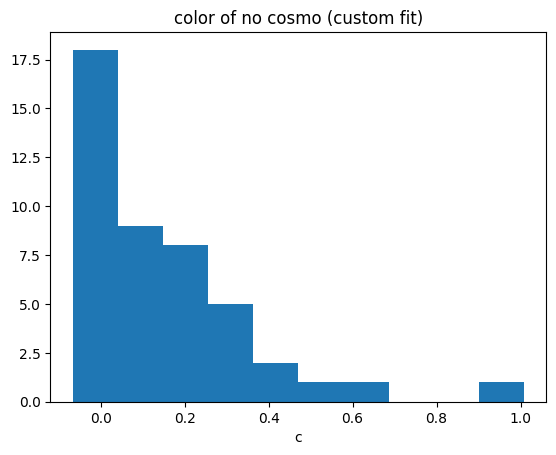

In [34]:
plt.hist(results_fit_no_cosmo['c'])
plt.title('color of no cosmo (custom fit)')
plt.xlabel('c');

In [35]:
tmp = []
base_path = '/home/mgiunta/dati/Foundation_DR1/Foundation_DR1/'
lf = os.listdir(base_path)
for x in ['Foundation_DR1.IGNORE', 'Foundation_DR1.LIST', 'Foundation_DR1.README']:
    lf.remove(x)

for f in tqdm(lf):
    # tmp.append(fit_fnd(base_path + f))
    tmp.append({'id':f.removeprefix('Foundation_DR1_').removesuffix('.txt'), **fit_fnd(base_path + f)})


results_fit_cosmo = pd.DataFrame(tmp)

  0%|          | 0/180 [00:00<?, ?it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  2%|▏         | 3/180 [00:00<00:36,  4.86it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  2%|▏         | 4/180 [00:00<00:36,  4.83it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  3%|▎         | 5/180 [00:01<00:36,  4.83it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength 

In [36]:
results_fit_cosmo

,id,redshift,redshift_err,t0,x0,x1,c,cov_t0_x0,cov_t0_x1,cov_t0_c,cov_x0_x1,cov_x0_c,cov_x1_c,t0_err,x0_err,x1_err,c_err
0,2016W,0.019253,0.000067,57417.822665,0.008469,-1.393788,0.054179,2.952206e-06,-0.002313,-0.000325,-5.326900e-06,-0.000008,0.000145,0.124371,0.000293,0.100208,0.031653
1,2016afk,0.045605,0.000007,57440.677613,0.001404,-0.113189,0.059432,-7.488848e-08,-0.035401,-0.001229,-1.816381e-06,-0.000001,0.001292,0.317023,0.000051,0.184695,0.031071
2,ASASSN-15bc,0.036715,0.000097,57047.858036,0.002581,0.586123,0.049946,2.954369e-06,-0.009124,-0.000787,-2.813662e-06,-0.000002,0.000677,0.159930,0.000080,0.147288,0.026848
3,ASASSN-15fa,0.027345,0.000007,57103.361664,0.004243,-0.403151,0.055054,-2.353428e-06,-0.017054,-0.000790,-8.576970e-07,-0.000003,0.000238,0.260302,0.000137,0.102856,0.028535
4,ASASSN-15fs,0.029020,0.000047,57113.331948,0.005600,0.040508,0.007397,-1.793879e-06,-0.012426,-0.000406,-1.165059e-09,-0.000004,-0.000112,0.202751,0.000177,0.100297,0.027563
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,SN2017jl,0.016331,0.000444,57784.958537,0.022378,0.667121,-0.000608,-2.168046e-07,0.006534,-0.000032,-1.486175e-05,-0.000019,0.000222,0.105669,0.000730,0.120511,0.029261
176,SN2017mf,0.025612,0.000009,57779.130873,0.005519,-0.096773,-0.014698,-6.527175e-06,-0.032603,-0.001530,-1.043999e-06,-0.000005,0.000412,0.351382,0.000182,0.137662,0.029749
177,SN2017ms,0.024483,0.000008,57782.171159,0.008619,0.585188,-0.122535,2.464158e-05,-0.046949,-0.001912,-1.427424e-05,-0.000007,0.000746,0.334049,0.000283,0.197031,0.029523
178,iPTF16auf,0.015018,0.000005,57538.094477,0.013015,0.135663,0.065898,-1.684945e-06,0.000394,0.000103,-4.398052e-06,-0.000011,0.000192,0.087414,0.000420,0.077230,0.028382


In [37]:
official_fit_cosmo = Table.read('/home/mgiunta/dati/Foundation_DR1/Foundation_DR1.FITRES.TEXT', format='ascii').to_pandas()
official_fit_cosmo.loc[official_fit_cosmo['CID'] == 'AT2016aj', 'CID'] = 'AT2016ajl'
official_fit_cosmo

,VARNAMES:,CID,IDSURVEY,TYPE,FIELD,CUTFLAG_SNANA,zHEL,zHELERR,zCMB,zCMBERR,...,mB,mBERR,x0,x0ERR,COV_x1_c,COV_x1_x0,COV_c_x0,NDOF,FITCHI2,FITPROB
0,SN:,2016afk,150,1,NULL,3,0.04561,0.00001,0.04672,0.00001,...,17.48197,0.043180,0.001825,0.000073,0.001788,-0.000004,-0.000002,14,48.11647,1.257470e-05
1,SN:,2016W,150,1,NULL,3,0.01925,0.00007,0.01856,0.00007,...,15.54516,0.039879,0.010863,0.000399,0.000049,-0.000006,-0.000012,10,17.96674,5.552720e-02
2,SN:,ASASSN-15bc,150,1,NULL,3,0.03672,0.00010,0.03639,0.00010,...,16.84699,0.035494,0.003275,0.000107,0.000201,-0.000003,-0.000003,10,4.38669,9.282200e-01
3,SN:,ASASSN-15fa,150,1,NULL,3,0.02735,0.00001,0.02722,0.00001,...,16.29300,0.037145,0.005455,0.000187,0.000037,-0.000001,-0.000005,10,178.46399,4.881940e-33
4,SN:,ASASSN-15fs,150,1,NULL,3,0.02902,0.00005,0.02852,0.00005,...,15.99948,0.039238,0.007148,0.000258,0.000199,-0.000003,-0.000007,11,36.95209,1.173810e-04
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
175,SN:,SN2017cpu,150,1,NULL,3,0.05440,0.00001,0.05525,0.00001,...,17.10527,0.040269,0.002582,0.000096,-0.002380,0.000003,-0.000003,5,9.56884,8.841550e-02
176,SN:,SN2017hn,150,1,NULL,3,0.02385,0.00001,0.02490,0.00001,...,15.63640,0.038901,0.009987,0.000358,-0.000529,-0.000007,-0.000011,4,2.89850,5.749500e-01
177,SN:,SN2017jl,150,1,NULL,3,0.01633,0.00044,0.01530,0.00044,...,14.49525,0.038542,0.028569,0.001014,0.000090,-0.000017,-0.000028,8,6.28513,6.153300e-01
178,SN:,SN2017mf,150,1,NULL,3,0.02561,0.00001,0.02617,0.00001,...,16.00484,0.036569,0.007113,0.000240,0.000368,-0.000001,-0.000007,5,17.07078,4.367500e-03


In [38]:
tmp = []
base_path = '/home/mgiunta/dati/Foundation_DR1/Foundation_DR1_NoCosmo/'

for f in tqdm(os.listdir(base_path)):
    # tmp.append(fit_fnd(base_path + f))
    tmp.append({'id':f.removeprefix('Foundation_DR1_').removesuffix('.txt'), **fit_fnd(base_path + f, modelcov=False)})


results_fit_no_cosmo_nomodelcov = pd.DataFrame(tmp)

tmp = []
base_path = '/home/mgiunta/dati/Foundation_DR1/Foundation_DR1/'
lf = os.listdir(base_path)
for x in ['Foundation_DR1.IGNORE', 'Foundation_DR1.LIST', 'Foundation_DR1.README']:
    lf.remove(x)

for f in tqdm(lf):
    # tmp.append(fit_fnd(base_path + f))
    tmp.append({'id':f.removeprefix('Foundation_DR1_').removesuffix('.txt'), **fit_fnd(base_path + f, modelcov=False)})


results_fit_cosmo_nomodelcov = pd.DataFrame(tmp)

  0%|          | 0/45 [00:00<?, ?it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  2%|▏         | 1/45 [00:00<00:07,  6.27it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  4%|▍         | 2/45 [00:00<00:08,  5.10it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength range)
  warnings.warn("Dropping following bands from data: " +
  9%|▉         | 4/45 [00:00<00:07,  5.44it/s]/home/mgiunta/.local/lib/python3.14/site-packages/sncosmo/fitting.py:191: RuntimeWarning: Dropping following bands from data: ps1::z(out of model wavelength rang

In [39]:
mt = -2.5*np.log10(results_fit_cosmo.x0)+10.635
mf = -2.5*np.log10(results_fit_cosmo_nomodelcov.x0)+10.635

ct = results_fit_cosmo.c
cf = results_fit_cosmo_nomodelcov.c

print(f'true {np.corrcoef(mt, ct)[0, 1]}')
print(f'false {np.corrcoef(mf, cf)[0, 1]}')

true -0.0652499846899689
false 0.06726980630157446


In [40]:
print(f'true {np.corrcoef(-2.5*np.log10(results_fit_cosmo.loc[results_fit_cosmo.id != 'PS15cfn', 'x0'])+10.635,
                          results_fit_cosmo.loc[results_fit_cosmo.id != 'PS15cfn', 'c'])[0, 1]}')

true 0.02855544487518733


In [41]:
results_fit_cosmo.loc[results_fit_cosmo.c < -0.6]

,id,redshift,redshift_err,t0,x0,x1,c,cov_t0_x0,cov_t0_x1,cov_t0_c,cov_x0_x1,cov_x0_c,cov_x1_c,t0_err,x0_err,x1_err,c_err
119,PS15cfn,0.11057,0.00015,57280.330143,0.000327,47.674485,-0.753939,0.000007,-2.709077,0.013214,-0.01578,-0.000008,1.064933,0.639147,0.000311,50.910807,0.063357


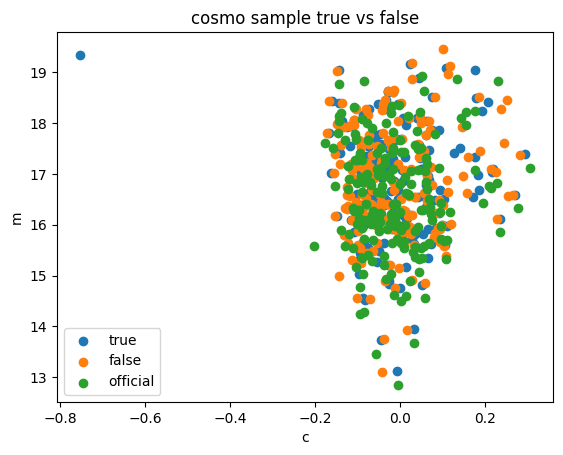

In [42]:
plt.scatter(ct, mt, label='true')
plt.scatter(cf, mf, label='false')
plt.scatter(official_fit_cosmo.c, official_fit_cosmo.mB, label='official')
plt.xlabel('c')
plt.ylabel('m')
plt.title('cosmo sample true vs false')
plt.legend();

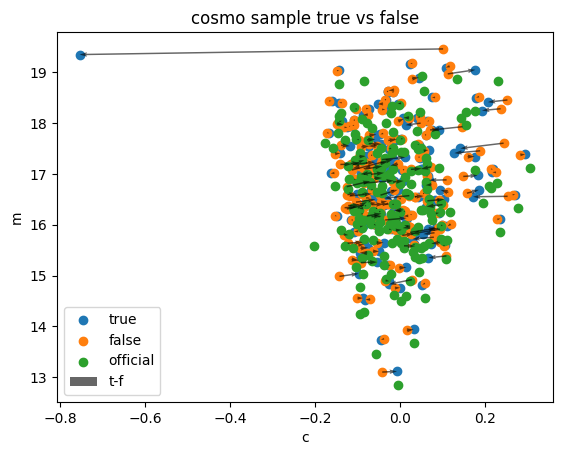

In [ ]:
plt.scatter(ct, mt, label='true')
plt.scatter(cf, mf, label='false')
plt.scatter(official_fit_cosmo.c, official_fit_cosmo.mB, label='official')
plt.xlabel('c')
plt.ylabel('m')

x_orig = cf
y_orig = mf
dx = ct - cf
dy = mt - mf
plt.quiver(x_orig, y_orig, dx, dy, angles='xy', scale_units='xy', scale=1, 
          color='black', alpha=0.6, width=0.003, label='t-f')
plt.title('cosmo sample true vs false')
plt.legend();

In [73]:
ids = ['ASASSN-15hy', 'ATLAS16ahj', 'CSS161013']

In [77]:
mti = -2.5*np.log10(results_fit_no_cosmo.loc[results_fit_no_cosmo.id.isin(ids), 'x0'])+10.635
mfi = -2.5*np.log10(results_fit_no_cosmo_nomodelcov.loc[results_fit_no_cosmo_nomodelcov.id.isin(ids), 'x0'])+10.635

cti = results_fit_no_cosmo.loc[results_fit_no_cosmo.id.isin(ids), 'c']
cfi = results_fit_no_cosmo_nomodelcov.loc[results_fit_no_cosmo_nomodelcov.id.isin(ids), 'c']

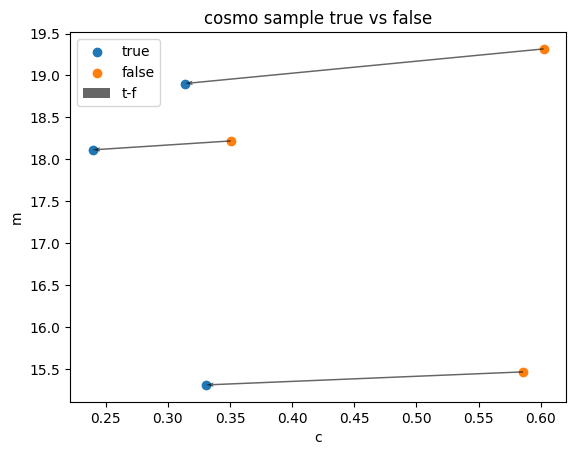

In [78]:
ids = ['ASASSN-15hy', 'ATLAS16ahj', 'CSS161013']

plt.scatter(cti, mti, label='true')
plt.scatter(cfi, mfi, label='false')
plt.xlabel('c')
plt.ylabel('m')

x_orig = cfi
y_orig = mfi
dx = cti - cfi
dy = mti - mfi
plt.quiver(x_orig, y_orig, dx, dy, angles='xy', scale_units='xy', scale=1, 
          color='black', alpha=0.6, width=0.003, label='t-f')
plt.title('cosmo sample true vs false')
plt.legend();

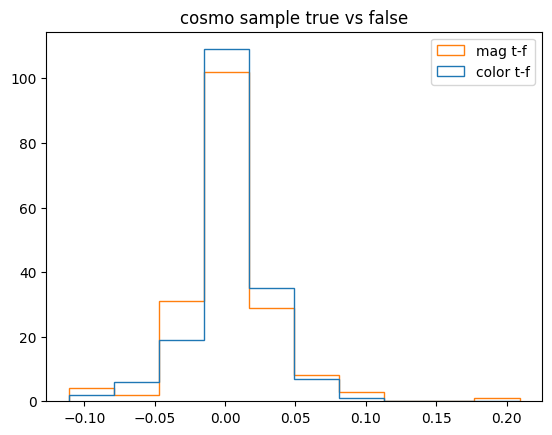

In [44]:
x_orig = cf
y_orig = mf
dx = ct - cf
dy = mt - mf
plt.hist([dx[dx>-0.5], dy], label=['color t-f', 'mag t-f'], histtype='step')

plt.title('cosmo sample true vs false')
plt.legend();

In [45]:
mt = -2.5*np.log10(results_fit_cosmo.x0)+10.635
mf = -2.5*np.log10(results_fit_cosmo_nomodelcov.x0)+10.635

xt = results_fit_cosmo.x1
xf = results_fit_cosmo_nomodelcov.x1

print(f'true {np.corrcoef(mt, xt)[0, 1]}')
print(f'false {np.corrcoef(mf, xf)[0, 1]}')

true 0.1568251217268054
false 0.06354971886152751


In [46]:
mnt = -2.5*np.log10(results_fit_no_cosmo.x0)+10.635
mnf = -2.5*np.log10(results_fit_no_cosmo_nomodelcov.x0)+10.635

cnt = results_fit_no_cosmo.c
cnf = results_fit_no_cosmo_nomodelcov.c

print(f'true {np.corrcoef(mnt, cnt)[0, 1]}')
print(f'false {np.corrcoef(mnf, cnf)[0, 1]}')

true 0.09903276008054215
false 0.12345684158924149


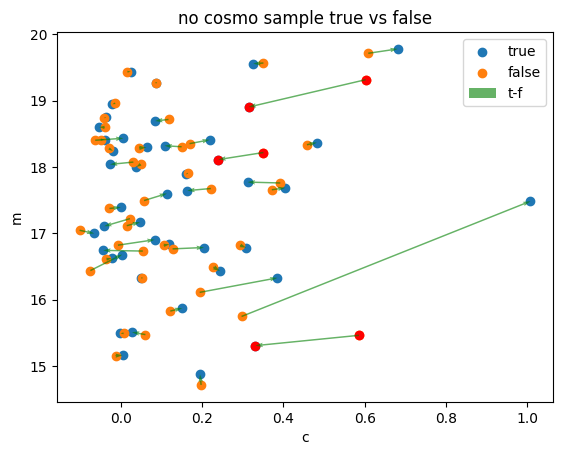

In [79]:
plt.scatter(cnt, mnt, label='true')
plt.scatter(cnf, mnf, label='false')
plt.xlabel('c')
plt.ylabel('m')

plt.scatter(cti, mti, color='red')
plt.scatter(cfi, mfi, color='red')

x_orig = cnf
y_orig = mnf
dx = cnt - cnf
dy = mnt - mnf
plt.quiver(x_orig, y_orig, dx, dy, angles='xy', scale_units='xy', scale=1, 
          color='green', alpha=0.6, width=0.003, label='t-f')
plt.title('no cosmo sample true vs false')
plt.legend();

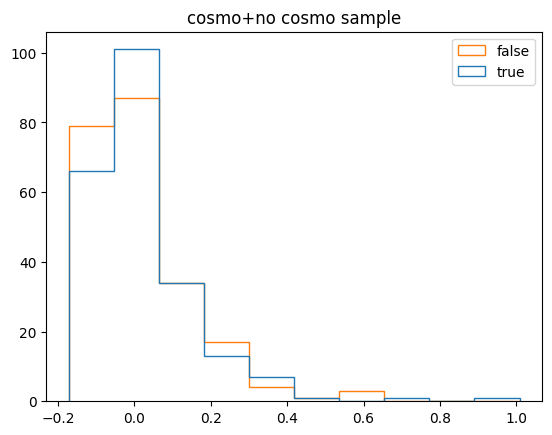

In [48]:
v = np.append(cnt, ct)
v = v[v>-0.5]
plt.hist([v, np.append(cnf, cf)], label=['true', 'false'], histtype='step')
plt.title('cosmo+no cosmo sample')
plt.legend();

In [49]:
v.mean(), np.append(cnf, cf).mean(), np.append(cnt, ct).mean()

(np.float64(0.02116060084581783),
 np.float64(0.01648591548778354),
 np.float64(0.017715713012323293))

In [50]:
model = sncosmo.Model(source=sncosmo.SALT2Source('/home/mgiunta/dati/SALT2.JLA-B14'),
                      effects=[sncosmo.F99Dust()],
                      effect_names=['mw'],
                      effect_frames=['obs'])

In [51]:
res_all = pd.concat([results_fit_cosmo, results_fit_no_cosmo], ignore_index=True)
# res_all.loc[res_all.c < -0.5] # PS15cfn c=-0.753939
res_all = res_all.loc[res_all.c > -0.5]
res_all

,id,redshift,redshift_err,t0,x0,x1,c,cov_t0_x0,cov_t0_x1,cov_t0_c,cov_x0_x1,cov_x0_c,cov_x1_c,t0_err,x0_err,x1_err,c_err
0,2016W,0.019253,0.000067,57417.822665,0.008469,-1.393788,0.054179,2.952206e-06,-2.312937e-03,-3.254296e-04,-5.326900e-06,-8.102110e-06,0.000145,0.124371,0.000293,0.100208,0.031653
1,2016afk,0.045605,0.000007,57440.677613,0.001404,-0.113189,0.059432,-7.488848e-08,-3.540057e-02,-1.229060e-03,-1.816381e-06,-1.429394e-06,0.001292,0.317023,0.000051,0.184695,0.031071
2,ASASSN-15bc,0.036715,0.000097,57047.858036,0.002581,0.586123,0.049946,2.954369e-06,-9.124316e-03,-7.866906e-04,-2.813662e-06,-1.899287e-06,0.000677,0.159930,0.000080,0.147288,0.026848
3,ASASSN-15fa,0.027345,0.000007,57103.361664,0.004243,-0.403151,0.055054,-2.353428e-06,-1.705407e-02,-7.896546e-04,-8.576970e-07,-3.414193e-06,0.000238,0.260302,0.000137,0.102856,0.028535
4,ASASSN-15fs,0.029020,0.000047,57113.331948,0.005600,0.040508,0.007397,-1.793879e-06,-1.242605e-02,-4.055576e-04,-1.165059e-09,-4.273791e-06,-0.000112,0.202751,0.000177,0.100297,0.027563
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
220,SN2016cuv,0.083200,0.000165,57554.944521,0.000569,0.264256,-0.036221,-1.961104e-05,-2.805932e-01,7.925485e-03,4.547143e-07,-1.192010e-06,0.003401,0.945123,0.000035,0.459196,0.040687
221,SN2017lc,0.060000,0.002000,57773.393911,0.000759,-0.675488,0.005687,-7.309017e-14,-1.449931e-10,2.343157e-11,-1.261105e-06,-9.690642e-07,-0.001063,0.000040,0.000033,0.226260,0.035440
222,SN2017mu,0.081617,0.000425,57772.698809,0.000474,0.203848,-0.021374,-1.550168e-05,-1.986860e-01,1.027839e-02,-1.019587e-06,-1.434970e-06,0.004845,0.805009,0.000035,0.413078,0.046087
223,SN2017nw,0.076960,0.000070,57777.226975,0.000774,1.447505,-0.040175,-3.661858e-05,-3.163162e-01,1.578251e-02,6.173449e-06,-1.339602e-06,-0.004038,1.182387,0.000044,0.380218,0.038059


In [61]:
sum((res_all.c < -0.3) | (res_all.c > 0.3))

10

In [53]:
sd = simplebayesn.preprocess_data(res_all)
sd

key,shape,preview (first elements)
m_app,"(224,)","[15.81541159, 17.76683501, 17.1054998 , 16.56581025, 16.2644356 , 16.12120676, 16.86109019, 15.44965244]"
c_app,"(224,)","[ 0.05417934, 0.05943235, 0.04994585, 0.05505355, 0.00739684, 0.23529832, 0.00730817, -0.09535257]"
x,"(224,)","[-1.393788 , -0.11318923, 0.58612302, -0.40315057, 0.04050807, 2.51551061, -1.22541846, 1.24351811]"
z,"(224,)","[0.019253 , 0.0456054, 0.036715 , 0.0273452, 0.02902 , 0.018923 , 0.0299174, 0.023316 ]"
sigma_z,"(224,)","[6.70e-05, 6.70e-06, 9.70e-05, 7.20e-06, 4.70e-05, 1.50e-04, 1.05e-05, 1.50e-04]"
dist_mod,"(224,)","[34.6865296 , 36.60092734, 36.11613995, 35.46145482, 35.59320992, 34.64845355, 35.66077197, 35.10886032]"
sigma_mu_z2,"(224,)","[0.01279545, 0.00227037, 0.00353577, 0.00631495, 0.00561917, 0.01348279, 0.00527606, 0.00888079]"
cov,"(224, 3, 3)",
inv_cov,"(224, 3, 3)",


In [54]:
iv = simplebayesn.initialize.sample_initial_values_uniform(sd.num_samples, 1234)
gd = simplebayesn.samplers.gibbs_numpy(iv, simplebayesn.distributions.priors.numpy.get_priors_params_uniform_priors(),
                                       sd, int(1e5), 1234)

100%|██████████| 100000/100000 [01:32<00:00, 1080.88it/s]


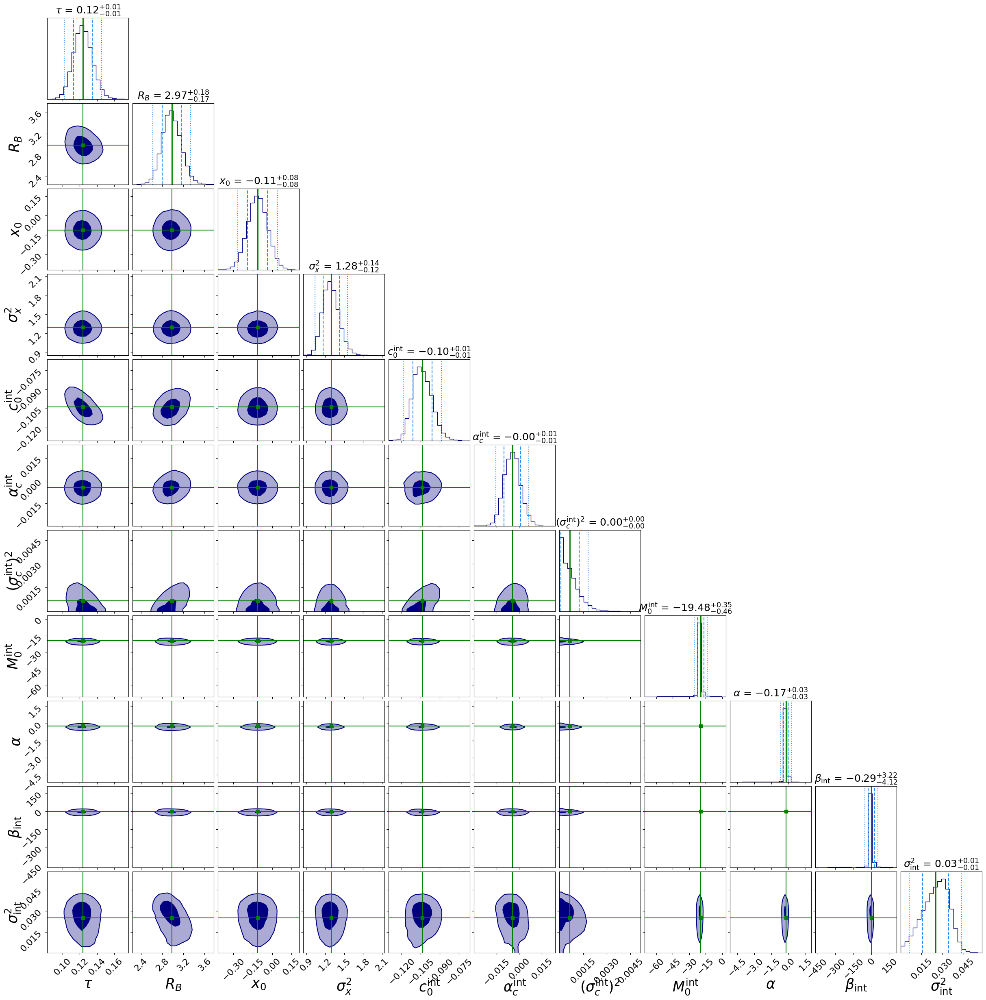

In [55]:
simplebayesn.visualize.posterior_cornerplot(gd, 1000);

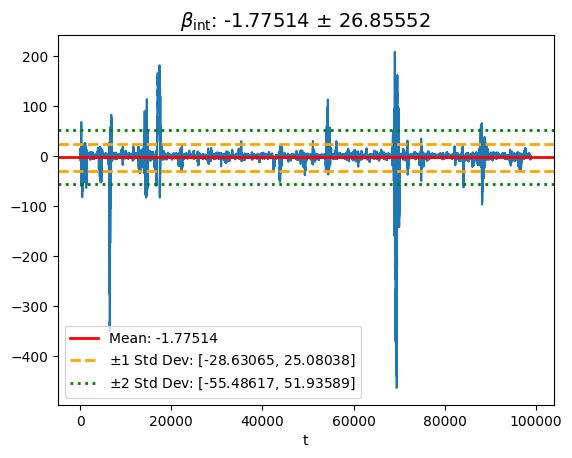

In [84]:
simplebayesn.visualize.trace_plot(gd, 'beta_int', 1000);

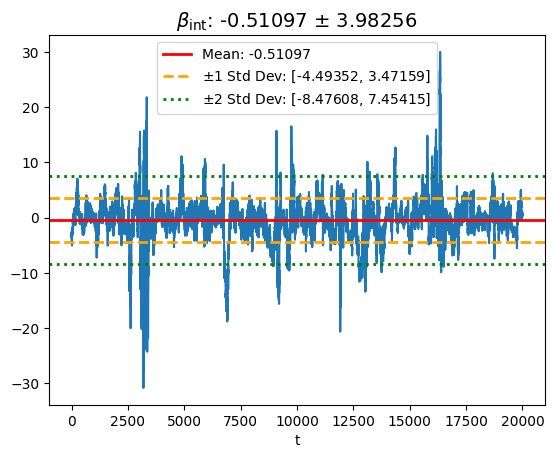

In [56]:
simplebayesn.visualize.trace_plot(gd, 'beta_int', 20000, 40000);

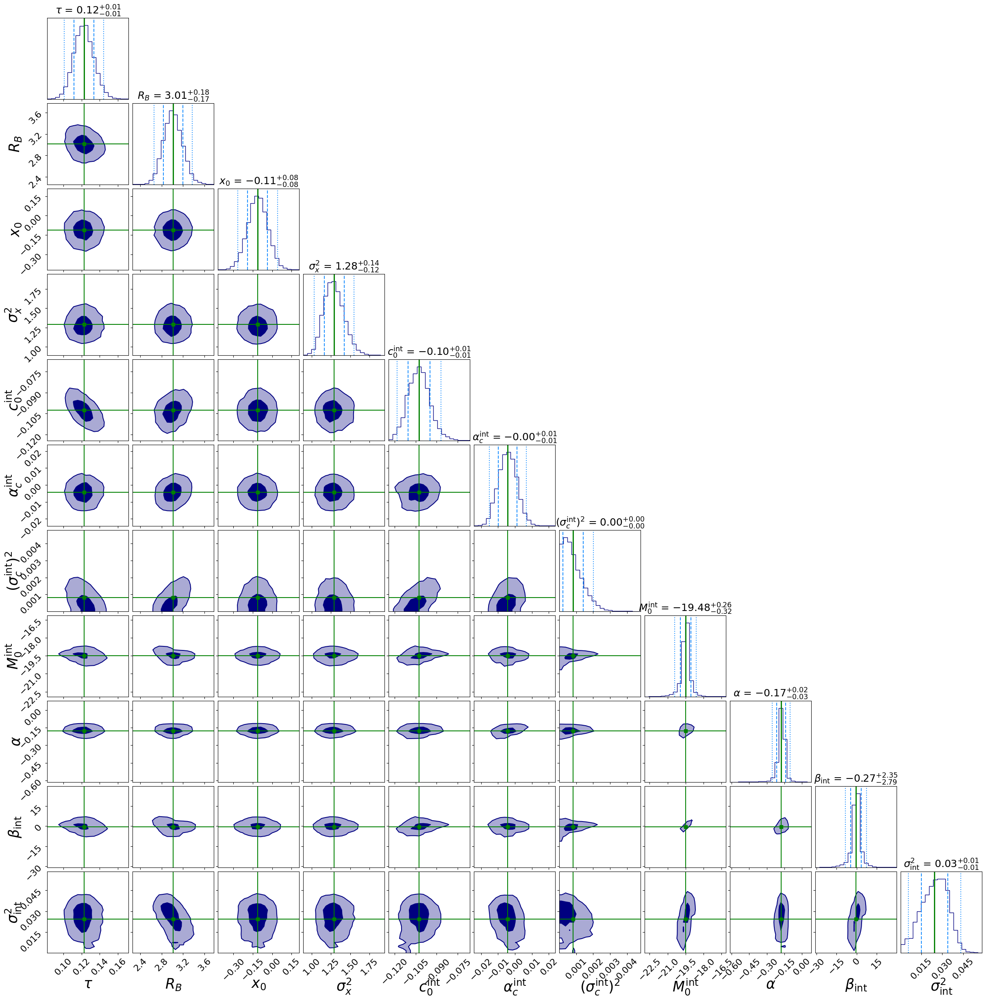

In [57]:
simplebayesn.visualize.posterior_cornerplot(gd, 20000, 40000);

In [63]:
anim, fig = simplebayesn.visualize.extinguished_magnitude_color_distribution_animation(gd, 20000, 40000, color_dust=True)
plt.close(fig)
HTML(anim.to_jshtml())

In [85]:
anim, fig = simplebayesn.visualize.intrinsic_magnitude_color_distribution_animation(gd, 1000, color_dust=True)
plt.close(fig)
HTML(anim.to_jshtml())

In [68]:
res_all.loc[res_all.id.isin(['ASASSN-15hy', 'ATLAS16ahj', 'CSS161013'])]

,id,redshift,redshift_err,t0,x0,x1,c,cov_t0_x0,cov_t0_x1,cov_t0_c,cov_x0_x1,cov_x0_c,cov_x1_c,t0_err,x0_err,x1_err,c_err
182,ASASSN-15hy,0.017930,0.000220,57153.377384,0.013501,2.914053,0.330886,-0.000020,0.025482,0.000826,-3.996270e-05,-0.000018,0.000445,0.359758,0.000546,0.281193,0.039023
194,ATLAS16ahj,0.073016,0.000016,57463.220974,0.000492,-1.367719,0.314048,-0.000009,-0.071284,0.007304,6.393576e-07,-0.000002,-0.000141,0.572511,0.000035,0.206024,0.056148
199,CSS161013,0.079000,0.003000,57695.259367,0.001021,2.121510,0.239542,-0.000011,-0.169577,0.002611,1.637386e-06,-0.000001,-0.001758,0.777090,0.000040,0.385301,0.034722


In [67]:
res_all.loc[res_all.id.isin(['ASASSN-15hy', 'ATLAS16ahj', 'CSS161013']), ['id', 'x0', 'x1', 'c']]

,id,x0,x1,c
182,ASASSN-15hy,0.013501,2.914053,0.330886
194,ATLAS16ahj,0.000492,-1.367719,0.314048
199,CSS161013,0.001021,2.121510,0.239542


In [70]:
res_all = pd.concat([results_fit_cosmo, results_fit_no_cosmo], ignore_index=True)

In [71]:
res_all_nomodelcov = pd.concat([results_fit_cosmo_nomodelcov, results_fit_no_cosmo_nomodelcov], ignore_index=True)

In [58]:
sd_ztf = simplebayesn.preprocess_data(ztf_hq_vl)
sd_ztf

key,shape,preview (first elements)
m_app,"(923,)","[16.26778323, 16.59373462, 18.09349138, 16.91127903, 17.59542832, 15.91300347, 17.79544311, 17.83286355]"
c_app,"(923,)","[-0.14860862, -0.09761537, 0.41288661, -0.11233989, -0.10817033, -0.16248349, 0.02529162, 0.33761552]"
x,"(923,)","[-0.71109983, -0.04793129, -1.88361405, -1.96944883, 0.31585622, 0.16995895, 0.93323721, -0.66596441]"
z,"(923,)","[0.02974109, 0.04036722, 0.03235875, 0.04114499, 0.053865 , 0.02435577, 0.05275113, 0.03588143]"
sigma_z,"(923,)","[1.12100e-05, 3.88973e-03, 1.75000e-05, 1.34400e-05, 1.31300e-05, 1.24300e-05, 1.41500e-05, 2.61400e-05]"
dist_mod,"(923,)","[35.64765636, 36.32780843, 35.83499171, 36.37046784, 36.97515356, 35.20526995, 36.92806535, 36.06495616]"
sigma_mu_z2,"(923,)","[0.00533888, 0.04667911, 0.00451086, 0.00278968, 0.00162769, 0.0079611 , 0.0016972 , 0.00367 ]"
cov,"(923, 3, 3)",
inv_cov,"(923, 3, 3)",


In [59]:
iv_ztf = simplebayesn.initialize.sample_initial_values_uniform(sd_ztf.num_samples, 1234)
gd_ztf = simplebayesn.samplers.gibbs_numpy(iv_ztf, simplebayesn.distributions.priors.numpy.get_priors_params_uniform_priors(),
                                           sd_ztf, int(1e5), 1234)

100%|██████████| 100000/100000 [02:19<00:00, 714.69it/s]


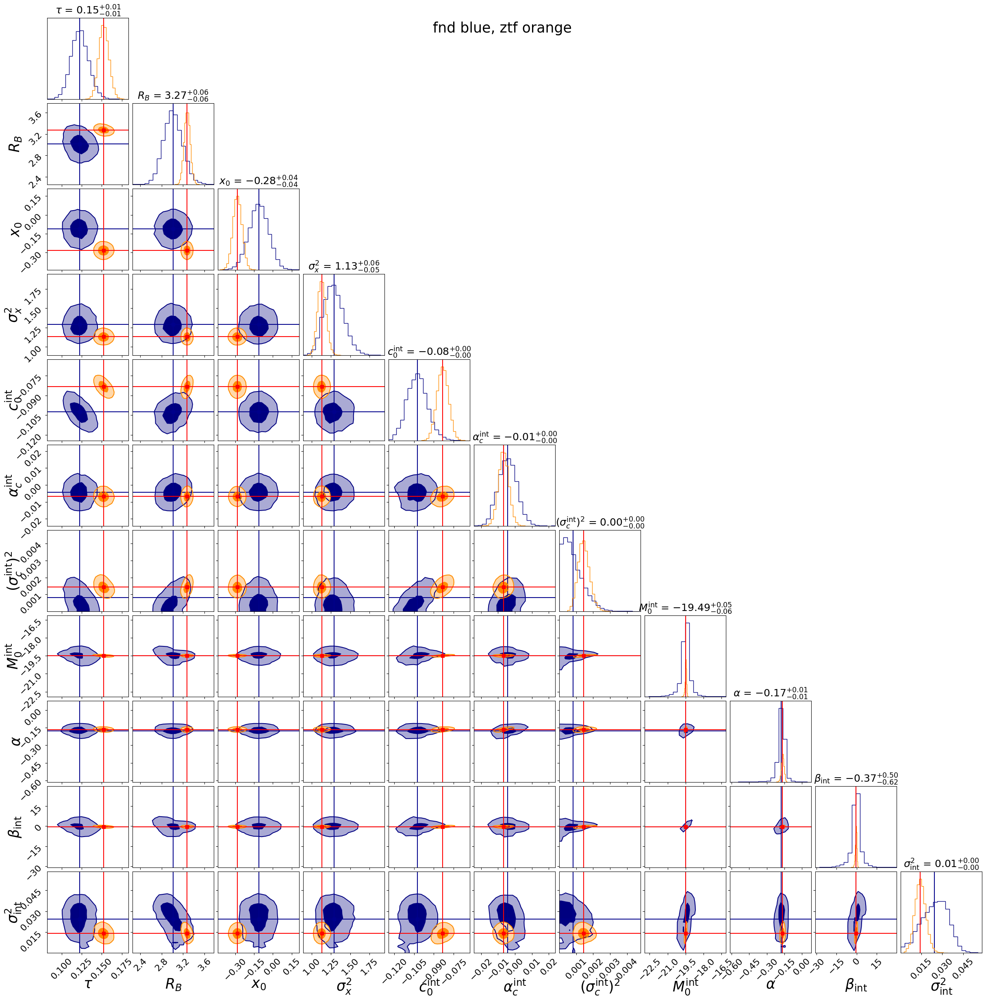

In [60]:
fig = simplebayesn.visualize.posterior_cornerplot(gd, 20000, 40000, title='fnd blue, ztf orange', mean_color='darkblue',
                                                  show_marginal_mean=False, show_marginal_std=False);
simplebayesn.visualize.posterior_cornerplot(gd_ztf, 1000, contours_color='darkorange', mean_color='red',
                                            show_marginal_mean=False, show_marginal_std=False, fig=fig);

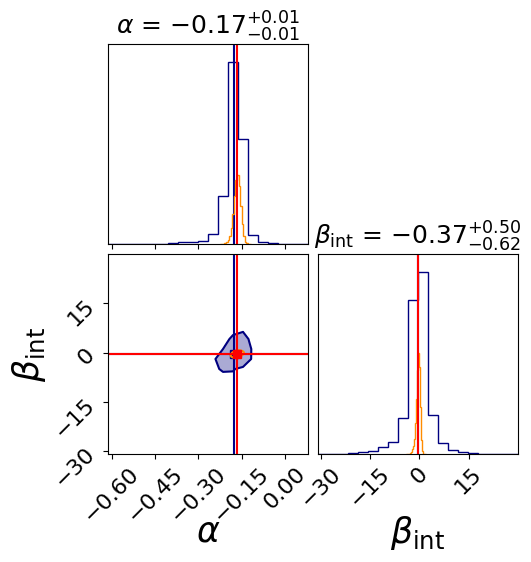

In [83]:
pp = ['alpha','beta_int']

fig = simplebayesn.visualize.posterior_cornerplot(gd, 20000, 40000, mean_color='darkblue',
                                                  show_marginal_mean=False, show_marginal_std=False, params_to_plot=pp);
simplebayesn.visualize.posterior_cornerplot(gd_ztf, 1000, contours_color='darkorange', mean_color='red',
                                            show_marginal_mean=False, show_marginal_std=False, fig=fig, params_to_plot=pp);

In [ ]:
# 0.003 0.003

In [87]:
d = simplebayesn.distributions.priors.numpy.get_priors_params_uniform_priors()
d['c']['alpha_prior'] = 0.003
d['c']['beta_prior'] = 0.003
d

{'tau': {'alpha_prior': -1, 'beta_prior': 0},
 'RB': {'mean_prior': None, 'std_prior': None},
 'x': {'alpha_prior': -1,
  'beta_prior': 0,
  'inv_cov_prior': None,
  'mean_prior': array([0])},
 'c': {'alpha_prior': 0.003,
  'beta_prior': 0.003,
  'inv_cov_prior': None,
  'mean_prior': array([0, 0])},
 'M': {'alpha_prior': -1,
  'beta_prior': 0,
  'inv_cov_prior': None,
  'mean_prior': array([0, 0, 0])}}

In [ ]:
iv = simplebayesn.initialize.sample_initial_values_uniform(sd.num_samples, 1234)
gd1 = simplebayesn.samplers.gibbs_numpy(iv, d,
                                        sd, int(1e5), 1234)

100%|██████████| 100000/100000 [01:33<00:00, 1069.54it/s]


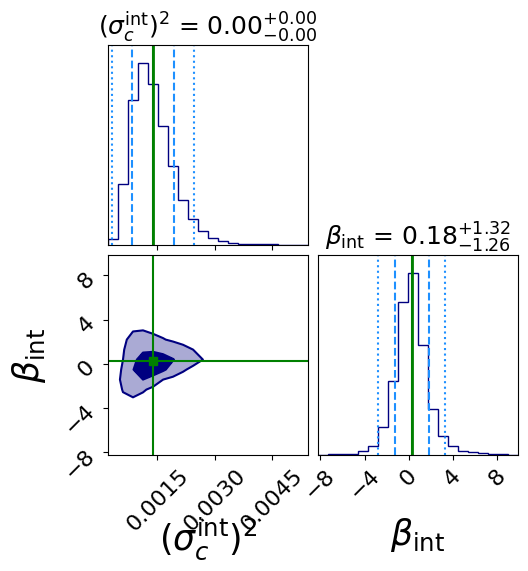

In [95]:
simplebayesn.visualize.posterior_cornerplot(gd1, params_to_plot=['sigmac_int2', 'beta_int'], start_idx=100);

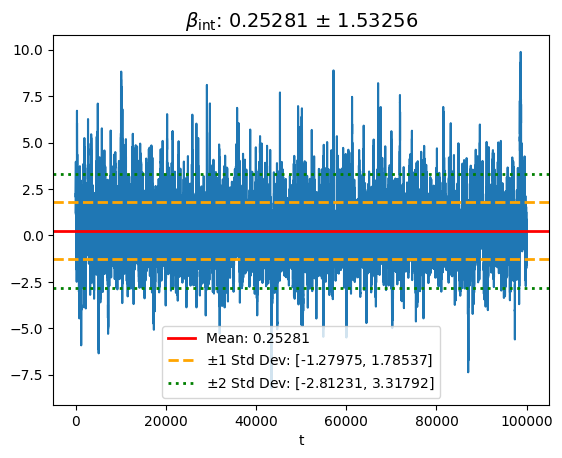

In [92]:
simplebayesn.visualize.trace_plot(gd1, 'beta_int');

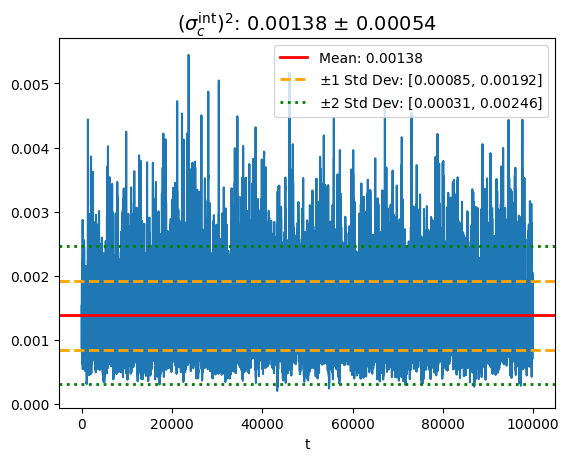

In [94]:
simplebayesn.visualize.trace_plot(gd1, 'sigmac_int2', 100);

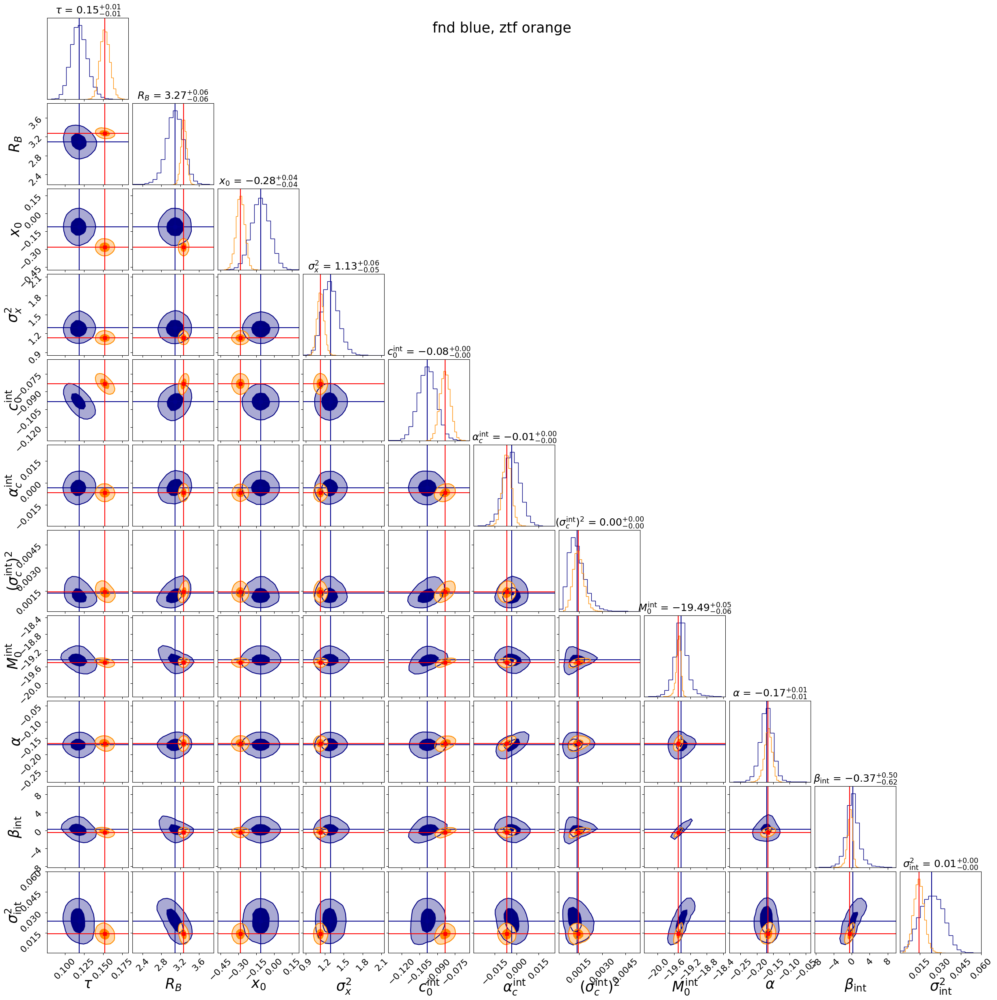

In [97]:
fig = simplebayesn.visualize.posterior_cornerplot(gd1, 100, title='fnd blue, ztf orange', mean_color='darkblue',
                                                  show_marginal_mean=False, show_marginal_std=False);
simplebayesn.visualize.posterior_cornerplot(gd_ztf, 1000, contours_color='darkorange', mean_color='red',
                                            show_marginal_mean=False, show_marginal_std=False, fig=fig);